In [1]:
using DifferentialEquations
using Plots
using TransferEntropy

In [31]:
A = [
  -1. 0. 0. 
  0. -2. 0.
  0. 0. -3.
]

function hurtzian(u,p,t)
  return A*u
  # du[1] = -5.0*u[1]+u[2]
  # du[2] = -1.0*u[2]
  # du[3] = -2.0*u[3]+u[2]
end
  
function σ_hurtzian(u,p,t)
  return ones(3)
end
  
prob_sde = SDEProblem(hurtzian,σ_hurtzian,[0.0,0.0,0.0],(0.0,100000.0))
sol = solve(prob_sde_hurtzian, EM(), dt=0.001, saveat=1.0)
1

1

In [32]:
plot(sol,vars=(1,3),seriestype = :scatter, markersize = .1, aspect_ratio = 1)

In [33]:
1/9

0.1111111111111111

In [34]:
dtM = mapreduce(permutedims, vcat, sol.u)
gamma = (transpose(dtM)*dtM)/length(dtM[:,1])

3×3 Matrix{Float64}:
  0.501632    -0.00136229   4.40784e-5
 -0.00136229   0.25063     -0.00139194
  4.40784e-5  -0.00139194   0.167302

In [18]:
sum(dtM[:,1].^2)/100001

0.5001904624032079

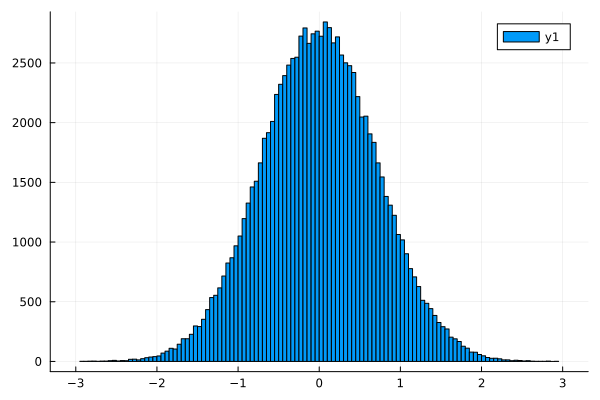

In [24]:
histogram(dtM[:,1])

In [10]:
invA = inv(A)
anaGam = invA*transpose(invA)

3×3 Matrix{Float64}:
 1.0  0.0  0.0
 0.0  1.0  0.0
 0.0  0.0  1.0

In [30]:
est = Kraskov(k = 4)
for s in [1,2,3]
    for d in [1,2,3]
        if s == d
            continue
        end
        (s+d == 3) ? c = 3 : ((s+d == 4) ? c = 2 : c = 1)
        source = [sol.u[i][s] for i in 1:length(sol.u)]
        dest = [sol.u[i][d] for i in 1:length(sol.u)]
        cond = [sol.u[i][c] for i in 1:length(sol.u)]
        print("Transfer from ", s, " to ", d, " cond ", c,": ")
        println(transferentropy(source, dest, cond, est))
    end
end

Transfer from 1 to 2 cond 3: 0.01693803208823219
Transfer from 1 to 3 cond 2: 0.012931236664638135
Transfer from 2 to 1 cond 3: 0.03218758726394633
Transfer from 2 to 3 cond 1: 0.054553323231770534
Transfer from 3 to 1 cond 2: 0.007367926497611421
Transfer from 3 to 2 cond 1: 0.011337950353903281


## Ornstein-Uhlenbeck Process

In [70]:
λ = 0.5
q = 1.0

function OUf(u,p,t)
    return -λ*u
end

function σ_OU(u,p,t)
    return q
end
plot()
varval = 0.
reps = 1000
prob_sde = SDEProblem(OUf,σ_OU,1.0,(0.0,10.0))
for _ in 1:(reps-1)
    sol = solve(prob_sde, EM(), dt=0.01, saveat=0.01)
    plot!(sol)
    varval += (last(sol.u) - ℯ^(-0.5*last(sol.t)))^2
end
varval/reps

0.9830579766713826

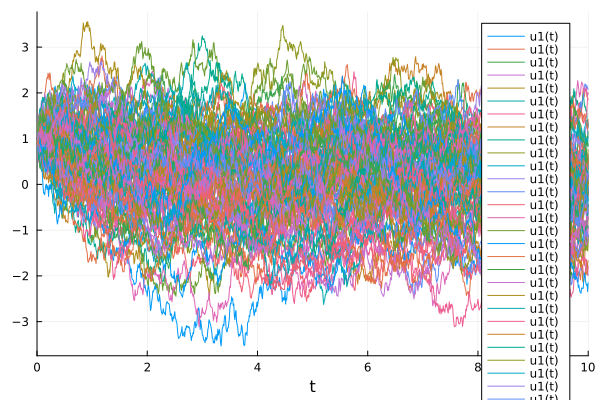

In [62]:
plot!()

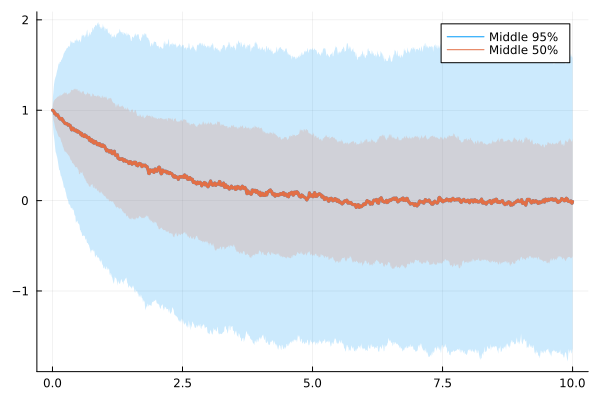

In [63]:
ensembleprob = EnsembleProblem(prob_sde)
sol = solve(ensembleprob,EnsembleThreads(),trajectories=1000)
using DifferentialEquations.EnsembleAnalysis
summ = EnsembleSummary(sol,0:0.01:10)
plot(summ,labels="Middle 95%")
summ = EnsembleSummary(sol,0:0.01:10;quantiles=[0.25,0.75])
plot!(summ,labels="Middle 50%",legend=true)